# Import Modules

In [1]:
from __future__ import print_function
#%matplotlib inline
import argparse
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

# Set random seed for reproducibility
manualSeed = 999
print("Random Seed: ", manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed)

Random Seed:  999


In [2]:
torch.cuda.empty_cache()

# Define Constants

In [3]:
# Root directory for dataset
dataroot = "data"

# Number of workers for dataloader
workers = 2

# Batch size during training
batch_size = 128

# Spatial size of training images. All images will be resized to this
#   size using a transformer.
image_size = 64

# Number of channels in the training images. For color images this is 3
nc = 3

# Size of z latent vector (i.e. size of generator input)
nz = 100

# Size of feature maps in generator
ngf = 64

# Size of feature maps in discriminator
ndf = 64

# Number of training epochs
num_epochs = 40

# Learning rate for optimizers
lr = 0.0002

# Beta1 hyperparameter for Adam optimizers
beta1 = 0.5

# Number of GPUs available. Use 0 for CPU mode.
ngpu = 1

# Data Preparation: Anime Face Dataset

In [4]:
# Create the dataset
dataset = dset.ImageFolder(root=dataroot,
                           transform=transforms.Compose([
                               transforms.Resize(image_size),
                               transforms.CenterCrop(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                           ]))

In [5]:
# Create the dataloader
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True, num_workers=workers)

In [6]:
# Decide which device we want to run on
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

In [7]:
device

device(type='cuda', index=0)

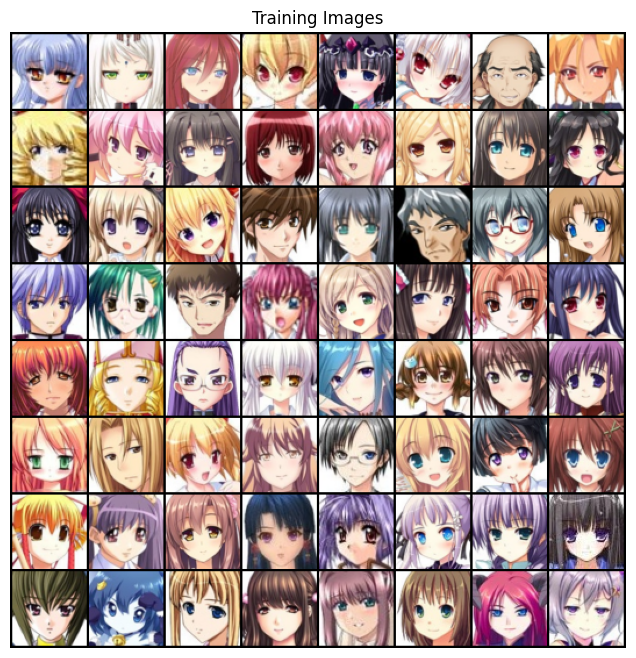

In [8]:
# Plot some training images
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

# Implementation

## Weight Initialization
From the DCGAN paper, Radford et al. (2016) specify that all weights shall be initialized from a Normal distribution (mean of 0 and standard deviation of 0.02). The following function takes an initialized model as input param and reinitializes all layers to meet the initialization criteria mentioned.

In [9]:
# custom weights initialization called on ``netG`` and ``netD``
def weights_init(m):
    '''
    Args:
    - m -> model
    '''
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

## Generator
The implementation of generator G aims to map the latent space vector (z) to data-space, in this case, an RGB anime face image with the same size as the given training images (i.e., 3x64x64).

In [10]:
# Generator Code

class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is Z, going into a convolution
            nn.ConvTranspose2d( nz, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            # state size. ``(ngf*8) x 4 x 4``
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # state size. ``(ngf*4) x 8 x 8``
            nn.ConvTranspose2d( ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # state size. ``(ngf*2) x 16 x 16``
            nn.ConvTranspose2d( ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # state size. ``(ngf) x 32 x 32``
            nn.ConvTranspose2d( ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size. ``(nc) x 64 x 64``
        )

    def forward(self, input):
        return self.main(input)

Instantiate the generator as well as apply the defined `weights_init` function.

In [11]:
# Create the generator
netG = Generator(ngpu).to(device)

# Handle multi-GPU if desired
if (device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))

# Apply the ``weights_init`` function to randomly initialize all weights
#  to ``mean=0``, ``stdev=0.02``.
netG.apply(weights_init)

# Print the model
print(netG)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)


The generator model has 14 layers in total. 5 of the layers are a strided two dimensional convolutional transpose layers paired with a 2d batch normalization and a ReLU activation function. Based on the DCGAN paper  (Radford et al., 2016), adding 2d batch normalization after the convolutional transpose layer is critical.

## Discriminator
The discriminator is a binary classification model that aims to classify whether the input is real or fake. The model takes image with the size of 3x64x64 as input and will output a scalar probability representing the labels (real or fake).

In [12]:
class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is ``(nc) x 64 x 64``
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf) x 32 x 32``
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf*2) x 16 x 16``
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf*4) x 8 x 8``
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf*8) x 4 x 4``
            nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input)

The discriminator model uses a series of convolutional 2d layers paired with activation function and batch normalization (except the first and the last layers).

Apply the weights initialization function to the created model.

In [13]:
# Create the Discriminator
netD = Discriminator(ngpu).to(device)

# Handle multi-GPU if desired
if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))

# Apply the ``weights_init`` function to randomly initialize all weights
# like this: ``to mean=0, stdev=0.2``.
netD.apply(weights_init)

# Print the model
print(netD)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)


## Loss Functions and Optimizers
In this implementation, BCE (Binary Cross Entropy) is used as the loss function and Adam is used as the optimizer for both generator and discriminator model.

In [14]:
# Initialize the ``BCELoss`` function
criterion = nn.BCELoss()

# Create batch of latent vectors that we will use to visualize
#  the progression of the generator
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

# Establish convention for real and fake labels during training
real_label = 1.
fake_label = 0.

# Setup Adam optimizers for both Generator and Discriminator
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

## Training

In [15]:
from datetime import datetime

In [16]:
start = datetime.now()
start_time = start.strftime("%H:%M:%S")
print("Start Time =", start_time)

# Training Loop

# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
iters = 0

print("Starting Training Loop...")
# For each epoch
for epoch in range(num_epochs):
    # For each batch in the dataloader
    for i, data in enumerate(dataloader, 0):

        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Train with all-real batch
        netD.zero_grad()
        # Format batch
        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        # Forward pass real batch through D
        output = netD(real_cpu).view(-1)
        # Calculate loss on all-real batch
        errD_real = criterion(output, label)
        # Calculate gradients for D in backward pass
        errD_real.backward()
        D_x = output.mean().item()

        ## Train with all-fake batch
        # Generate batch of latent vectors
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        # Generate fake image batch with G
        fake = netG(noise)
        label.fill_(fake_label)
        # Classify all fake batch with D
        output = netD(fake.detach()).view(-1)
        # Calculate D's loss on the all-fake batch
        errD_fake = criterion(output, label)
        # Calculate the gradients for this batch, accumulated (summed) with previous gradients
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        # Compute error of D as sum over the fake and the real batches
        errD = errD_real + errD_fake
        # Update D
        optimizerD.step()

        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        netG.zero_grad()
        label.fill_(real_label)  # fake labels are real for generator cost
        # Since we just updated D, perform another forward pass of all-fake batch through D
        output = netD(fake).view(-1)
        # Calculate G's loss based on this output
        errG = criterion(output, label)
        # Calculate gradients for G
        errG.backward()
        D_G_z2 = output.mean().item()
        # Update G
        optimizerG.step()

        # Output training stats
        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

        # Save Losses for plotting later
        G_losses.append(errG.item())
        D_losses.append(errD.item())

        # Check how the generator is doing by saving G's output on fixed_noise
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

        iters += 1
        
end = datetime.now()
end_time = end.strftime("%H:%M:%S")
print("End Time =", end_time)

Start Time = 22:05:08
Starting Training Loop...
[0/40][0/497]	Loss_D: 1.9439	Loss_G: 4.2980	D(x): 0.4451	D(G(z)): 0.5731 / 0.0199
[0/40][50/497]	Loss_D: 2.3647	Loss_G: 5.0378	D(x): 0.3244	D(G(z)): 0.0001 / 0.0167
[0/40][100/497]	Loss_D: 1.2889	Loss_G: 12.3776	D(x): 0.5471	D(G(z)): 0.0004 / 0.0000
[0/40][150/497]	Loss_D: 0.6967	Loss_G: 5.7797	D(x): 0.6834	D(G(z)): 0.0064 / 0.0045
[0/40][200/497]	Loss_D: 0.4306	Loss_G: 7.1081	D(x): 0.8676	D(G(z)): 0.1737 / 0.0039
[0/40][250/497]	Loss_D: 0.6759	Loss_G: 5.2914	D(x): 0.6697	D(G(z)): 0.0105 / 0.0100
[0/40][300/497]	Loss_D: 0.7084	Loss_G: 4.1899	D(x): 0.7591	D(G(z)): 0.2489 / 0.0292
[0/40][350/497]	Loss_D: 0.2497	Loss_G: 3.7622	D(x): 0.9490	D(G(z)): 0.1266 / 0.0411
[0/40][400/497]	Loss_D: 0.4262	Loss_G: 4.6577	D(x): 0.7493	D(G(z)): 0.0142 / 0.0295
[0/40][450/497]	Loss_D: 0.6879	Loss_G: 6.6060	D(x): 0.8187	D(G(z)): 0.2701 / 0.0029
[1/40][0/497]	Loss_D: 0.2586	Loss_G: 4.2503	D(x): 0.8464	D(G(z)): 0.0288 / 0.0251
[1/40][50/497]	Loss_D: 0.2854	Lo

[9/40][400/497]	Loss_D: 0.3381	Loss_G: 5.3659	D(x): 0.9526	D(G(z)): 0.2148 / 0.0087
[9/40][450/497]	Loss_D: 0.2821	Loss_G: 3.2907	D(x): 0.8490	D(G(z)): 0.0736 / 0.0728
[10/40][0/497]	Loss_D: 0.2966	Loss_G: 4.9400	D(x): 0.9329	D(G(z)): 0.1761 / 0.0124
[10/40][50/497]	Loss_D: 0.4102	Loss_G: 3.7335	D(x): 0.7588	D(G(z)): 0.0504 / 0.0408
[10/40][100/497]	Loss_D: 0.3323	Loss_G: 3.1376	D(x): 0.8440	D(G(z)): 0.1236 / 0.0615
[10/40][150/497]	Loss_D: 0.2111	Loss_G: 5.2426	D(x): 0.9446	D(G(z)): 0.1300 / 0.0090
[10/40][200/497]	Loss_D: 1.1848	Loss_G: 1.5253	D(x): 0.4026	D(G(z)): 0.0036 / 0.3109
[10/40][250/497]	Loss_D: 0.6338	Loss_G: 3.4128	D(x): 0.6324	D(G(z)): 0.0124 / 0.0629
[10/40][300/497]	Loss_D: 0.4459	Loss_G: 5.9624	D(x): 0.9786	D(G(z)): 0.3083 / 0.0047
[10/40][350/497]	Loss_D: 0.3233	Loss_G: 3.0702	D(x): 0.7762	D(G(z)): 0.0284 / 0.0803
[10/40][400/497]	Loss_D: 0.6795	Loss_G: 4.4310	D(x): 0.5968	D(G(z)): 0.0088 / 0.0239
[10/40][450/497]	Loss_D: 0.2562	Loss_G: 4.0792	D(x): 0.9189	D(G(z)): 0

[19/40][250/497]	Loss_D: 0.1972	Loss_G: 2.9027	D(x): 0.8818	D(G(z)): 0.0581 / 0.0835
[19/40][300/497]	Loss_D: 0.2669	Loss_G: 3.4066	D(x): 0.8761	D(G(z)): 0.1093 / 0.0488
[19/40][350/497]	Loss_D: 0.2235	Loss_G: 4.0984	D(x): 0.9458	D(G(z)): 0.1409 / 0.0250
[19/40][400/497]	Loss_D: 0.3675	Loss_G: 5.7551	D(x): 0.9420	D(G(z)): 0.2340 / 0.0055
[19/40][450/497]	Loss_D: 0.7021	Loss_G: 6.0426	D(x): 0.9828	D(G(z)): 0.4329 / 0.0041
[20/40][0/497]	Loss_D: 0.3013	Loss_G: 5.0557	D(x): 0.9637	D(G(z)): 0.2140 / 0.0093
[20/40][50/497]	Loss_D: 0.2862	Loss_G: 3.0929	D(x): 0.9071	D(G(z)): 0.1511 / 0.0699
[20/40][100/497]	Loss_D: 0.1853	Loss_G: 4.2101	D(x): 0.8647	D(G(z)): 0.0240 / 0.0240
[20/40][150/497]	Loss_D: 0.2146	Loss_G: 3.3520	D(x): 0.8911	D(G(z)): 0.0823 / 0.0608
[20/40][200/497]	Loss_D: 0.3161	Loss_G: 4.7734	D(x): 0.9725	D(G(z)): 0.2239 / 0.0134
[20/40][250/497]	Loss_D: 0.2674	Loss_G: 5.0058	D(x): 0.9619	D(G(z)): 0.1865 / 0.0101
[20/40][300/497]	Loss_D: 0.2865	Loss_G: 4.6503	D(x): 0.9353	D(G(z)):

[29/40][100/497]	Loss_D: 1.8827	Loss_G: 1.2359	D(x): 0.2282	D(G(z)): 0.0006 / 0.3910
[29/40][150/497]	Loss_D: 0.1005	Loss_G: 4.0673	D(x): 0.9405	D(G(z)): 0.0343 / 0.0266
[29/40][200/497]	Loss_D: 0.5542	Loss_G: 2.5539	D(x): 0.7860	D(G(z)): 0.2148 / 0.1083
[29/40][250/497]	Loss_D: 0.1882	Loss_G: 3.9417	D(x): 0.8746	D(G(z)): 0.0350 / 0.0353
[29/40][300/497]	Loss_D: 0.7391	Loss_G: 7.2203	D(x): 0.9949	D(G(z)): 0.4559 / 0.0013
[29/40][350/497]	Loss_D: 0.1517	Loss_G: 4.1171	D(x): 0.9468	D(G(z)): 0.0839 / 0.0235
[29/40][400/497]	Loss_D: 0.1304	Loss_G: 4.8373	D(x): 0.9681	D(G(z)): 0.0856 / 0.0137
[29/40][450/497]	Loss_D: 0.1592	Loss_G: 4.3386	D(x): 0.9536	D(G(z)): 0.0979 / 0.0213
[30/40][0/497]	Loss_D: 0.3788	Loss_G: 4.2161	D(x): 0.9036	D(G(z)): 0.2150 / 0.0237
[30/40][50/497]	Loss_D: 0.7360	Loss_G: 1.3550	D(x): 0.5469	D(G(z)): 0.0021 / 0.3331
[30/40][100/497]	Loss_D: 0.0764	Loss_G: 4.8467	D(x): 0.9457	D(G(z)): 0.0179 / 0.0142
[30/40][150/497]	Loss_D: 0.0835	Loss_G: 4.4497	D(x): 0.9420	D(G(z)):

[38/40][450/497]	Loss_D: 0.4103	Loss_G: 7.1061	D(x): 0.9853	D(G(z)): 0.2582 / 0.0025
[39/40][0/497]	Loss_D: 0.1312	Loss_G: 3.8387	D(x): 0.9164	D(G(z)): 0.0342 / 0.0403
[39/40][50/497]	Loss_D: 0.0886	Loss_G: 4.1384	D(x): 0.9613	D(G(z)): 0.0444 / 0.0302
[39/40][100/497]	Loss_D: 0.0425	Loss_G: 5.1302	D(x): 0.9748	D(G(z)): 0.0162 / 0.0107
[39/40][150/497]	Loss_D: 0.7461	Loss_G: 2.5413	D(x): 0.8534	D(G(z)): 0.3992 / 0.1172
[39/40][200/497]	Loss_D: 0.2300	Loss_G: 3.7911	D(x): 0.9024	D(G(z)): 0.0995 / 0.0384
[39/40][250/497]	Loss_D: 0.4108	Loss_G: 0.8129	D(x): 0.7218	D(G(z)): 0.0122 / 0.5296
[39/40][300/497]	Loss_D: 0.1699	Loss_G: 3.3613	D(x): 0.9050	D(G(z)): 0.0568 / 0.0605
[39/40][350/497]	Loss_D: 0.1785	Loss_G: 4.3165	D(x): 0.9269	D(G(z)): 0.0860 / 0.0231
[39/40][400/497]	Loss_D: 0.2872	Loss_G: 6.7262	D(x): 0.9915	D(G(z)): 0.2165 / 0.0021
[39/40][450/497]	Loss_D: 0.2158	Loss_G: 7.6126	D(x): 0.9913	D(G(z)): 0.1673 / 0.0008
End Time = 22:35:57


In [17]:
end-start

datetime.timedelta(seconds=1849, microseconds=26547)

# Results

## Loss vs Training Iteration
Generator and Discriminator loss over iterations

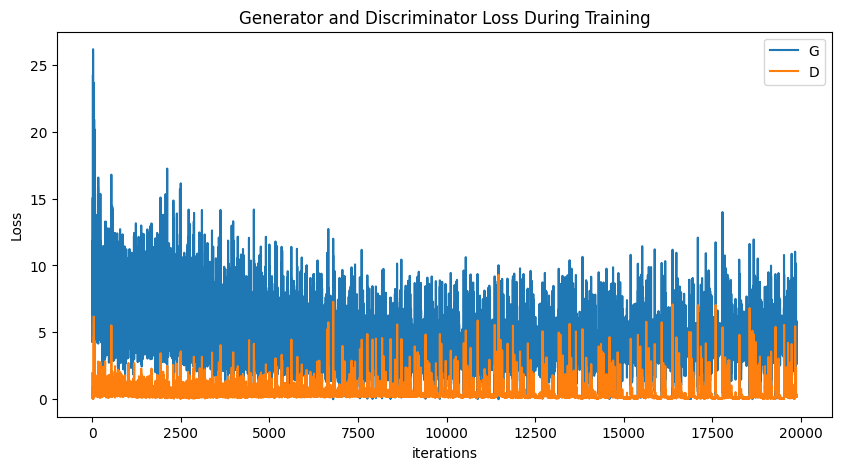

In [18]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

## Generator's Progression Visualization

Animation size has reached 21419998 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


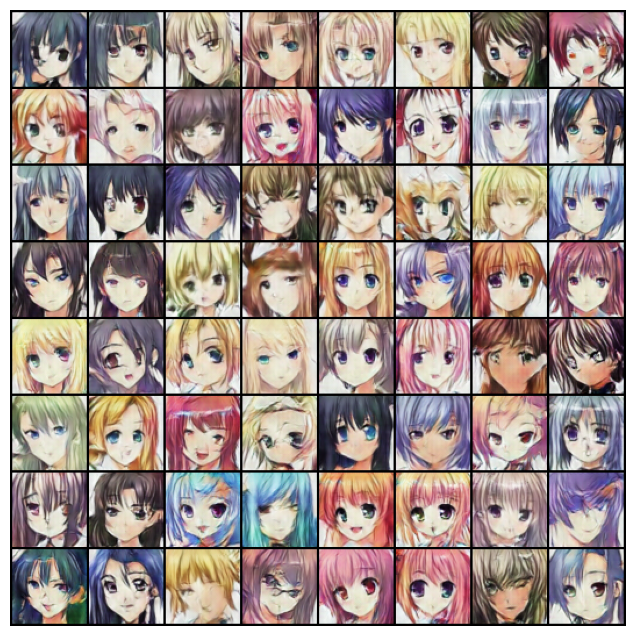

In [19]:
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

## Real Images vs Fake Images

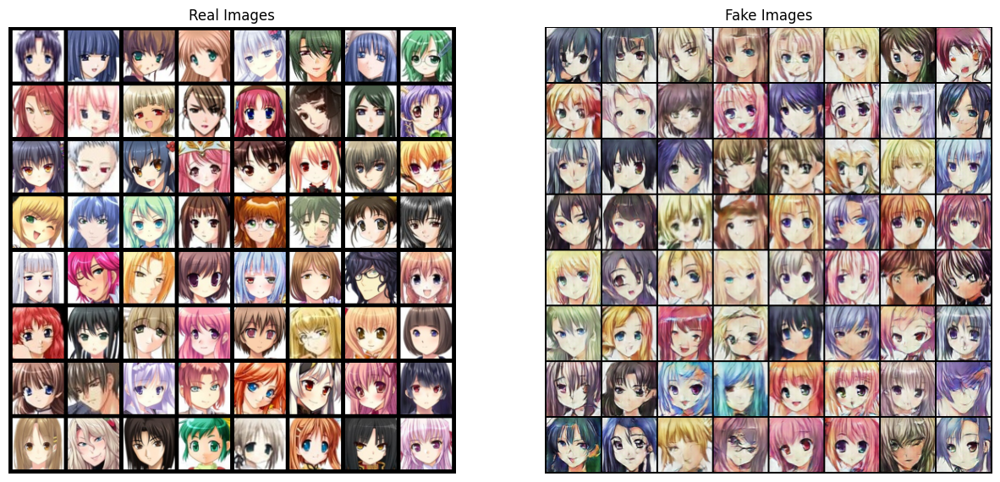

In [20]:
# Grab a batch of real images from the dataloader
real_batch = next(iter(dataloader))

# Plot the real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()

## Save Generator and Discriminator Model

In [21]:
expID = 'exp004'

In [22]:
torch.save(netG.state_dict(), f'models/netG_{expID}.pt')
torch.save(netD.state_dict(), f'models/netD_{expID}.pt')

Loading model example

In [23]:
loaded_netG = Generator(ngpu).to(device)
loaded_netG.load_state_dict(torch.load(f'models/netG_{expID}.pt'))
print(loaded_netG)
# loaded_netG.eval()

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)


In [24]:
loaded_netD = Discriminator(ngpu).to(device)
loaded_netD.load_state_dict(torch.load(f'models/netD_{expID}.pt'))
print(loaded_netD)
# loaded_netD.eval()

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)


## Pickle Fake Images Created during Training Iterations

In [25]:
from pickle import load, dump

In [26]:
with open(f'fake_images/fake_images_{expID}.pkl', 'wb') as f:
    dump(img_list, f)

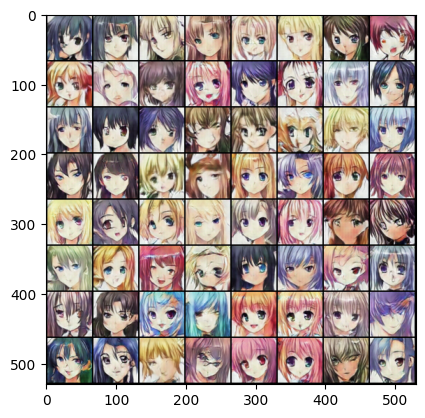

In [27]:
with open(f'fake_images/fake_images_{expID}.pkl', 'rb') as f:
    loaded_img_list = load(f)
    
plt.imshow(np.transpose(loaded_img_list[-1],(1,2,0)))

In [28]:
raise ValueError

ValueError: 

## [TO BE REVIEWED] Fretchet Distance Calculation

In [ ]:
def calculate_activation_statistics(images,model,batch_size=128, dims=2048,
                    cuda=False):
    model.eval()
    act=np.empty((len(images), dims))
    
    if cuda:
        batch=images.cuda()
    else:
        batch=images
    pred = model(batch)[0]

        # If model output is not scalar, apply global spatial average pooling.
        # This happens if you choose a dimensionality not equal 2048.
    if pred.size(2) != 1 or pred.size(3) != 1:
        pred = adaptive_avg_pool2d(pred, output_size=(1, 1))

    act= pred.cpu().data.numpy().reshape(pred.size(0), -1)
    
    mu = np.mean(act, axis=0)
    sigma = np.cov(act, rowvar=False)
    return mu, sigma

In [ ]:
def calculate_frechet_distance(mu1, sigma1, mu2, sigma2, eps=1e-6):
    """Numpy implementation of the Frechet Distance.
    The Frechet distance between two multivariate Gaussians X_1 ~ N(mu_1, C_1)
    and X_2 ~ N(mu_2, C_2) is
            d^2 = ||mu_1 - mu_2||^2 + Tr(C_1 + C_2 - 2*sqrt(C_1*C_2)).
    """

    mu1 = np.atleast_1d(mu1)
    mu2 = np.atleast_1d(mu2)

    sigma1 = np.atleast_2d(sigma1)
    sigma2 = np.atleast_2d(sigma2)

    assert mu1.shape == mu2.shape, \
        'Training and test mean vectors have different lengths'
    assert sigma1.shape == sigma2.shape, \
        'Training and test covariances have different dimensions'

    diff = mu1 - mu2
    covmean, _ = linalg.sqrtm(sigma1.dot(sigma2), disp=False)
    if not np.isfinite(covmean).all():
        msg = ('fid calculation produces singular product; '
               'adding %s to diagonal of cov estimates') % eps
        print(msg)
        offset = np.eye(sigma1.shape[0]) * eps
        covmean = linalg.sqrtm((sigma1 + offset).dot(sigma2 + offset))

    
    if np.iscomplexobj(covmean):
        if not np.allclose(np.diagonal(covmean).imag, 0, atol=1e-3):
            m = np.max(np.abs(covmean.imag))
            raise ValueError('Imaginary component {}'.format(m))
        covmean = covmean.real

    tr_covmean = np.trace(covmean)

    return (diff.dot(diff) + np.trace(sigma1) +
            np.trace(sigma2) - 2 * tr_covmean)

In [ ]:
def calculate_fretchet(images_real,images_fake,model):
    mu_1,std_1=calculate_activation_statistics(images_real,model,cuda=True)
    mu_2,std_2=calculate_activation_statistics(images_fake,model,cuda=True)

    """get fretched distance"""
    fid_value = calculate_frechet_distance(mu_1, std_1, mu_2, std_2)
    return fid_value